In [10]:
%matplotlib inline
from IPython.display import display, HTML
#from IPython import display#, HTML
display(HTML("<style>.container { width:80% !important; }</style>"))

import pandas as pd
import numpy as np
import xarray as xr
from importlib import reload
import matplotlib.pyplot as plt
import glob
import seaborn as sns
sns.set_style('ticks')
sns.set_context('poster')
import os
#from tools.common import colormaps
from matplotlib.colors import LogNorm, Normalize
import ectools
#print(dir(ectools))
#ecio=ectools.ecio
#ecplot=ectools.ecplot
from ectools import ecio
from ectools import ecplot as ecplt
from ectools import colormaps
import getopt
import shutil
import zipfile
from scipy.ndimage import gaussian_filter

In [11]:
reload(ecio)
reload(ecplt)
reload(colormaps)

Colormap 'SW' is already registered. Overwriting by default.
Colormap 'SW_r' is already registered. Overwriting by default.
Colormap 'LW' is already registered. Overwriting by default.
Colormap 'LW_r' is already registered. Overwriting by default.
Colormap 'LW_tops' is already registered. Overwriting by default.
Colormap 'LW_tops_r' is already registered. Overwriting by default.
Colormap 'chiljet2' is already registered. Overwriting by default.
Colormap 'chiljet3' is already registered. Overwriting by default.
Colormap 'calipso' is already registered. Overwriting by default.
Colormap 'calipso_smooth' is already registered. Overwriting by default.
Colormap 'litmus' is already registered. Overwriting by default.


<module 'ectools.colormaps' from '/net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/EC_tools_only/ectools/colormaps.py'>

In [12]:
#orbit_sequence='03508B'
#orbit_sequence='05731B'
orbit_sequence='03547D'
#orbit_sequence='03539B'
orbit_sequence='05731B'
orbit_sequence='05813C'
orbit_sequence='06015B'
#orbit_sequence='05901F'

orbit_sequence='05903C'
#orbit_sequence='05238D'
#orbit_sequence='08108B'

#orbit_sequence='07634D'
#orbit_sequence='01519H'
#orbit_sequence='01226F'

#oorbit_sequence='01226F'
#orbit_sequence='07302A'

#orbit_sequence='08581D'

#orbit_sequence='05696B'
#orbit_sequence='07302B'
orbit_sequence='05433C'
#orbit_sequence='09323F'
orbit_sequence='09325H'
orbit_sequence='06708D'

orbit_sequence='04679C'

#
# Directory of where you store the local data
#
src2='/net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/EC_tools_only/Working_DIR/'
fast=1
#
# Empty the working directory
#
for root, dirs, files in os.walk(src2):
    for file in files:
        print('file',file)
        os.remove(os.path.join(root, file))  # Remove each file
    for dir in dirs:
        print('dir',dir)
        shutil.rmtree(os.path.join(root, dir))  # Remove each subdirectory
#
# Copy the ANOM, AFM zip files, unzip and store in Working_DIR
#
#   Directory containing all the ANOM data
#
#if fast == 0: 
txt='/net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/L1/*/*/*/*/*_'+orbit_sequence+'*.ZIP'
txt2=src2+'/*_NOM_*'+orbit_sequence+'*'
filescheck2=glob.glob(txt)     
file_exist=glob.glob(txt2)
print(filescheck2, file_exist)
if not file_exist:

    for source_file in filescheck2:
        file = source_file.split('/')[-1]
        file= file.split('.')[0]
        #
        DIRCOPY=src2+file
        print(DIRCOPY)
        os.mkdir(DIRCOPY)  
        #stop
        file_name = os.path.basename(source_file)
                # Define the target path in the current directory
        target_file = os.path.join("./", file_name)
                # Step 1: Copy the file to the current directory  
        shutil.copy(source_file, target_file)
        print('XX',target_file)
        with zipfile.ZipFile(target_file, 'r') as zip_ref:
            zip_ref.extractall("./")
            h5_files = glob.glob("*_"+orbit_sequence+"*.h5")
            shutil.move(h5_files[0], DIRCOPY)            
            h5_files = glob.glob("*_"+orbit_sequence+"*.HDR")
            shutil.move(h5_files[0], DIRCOPY)
    #            stop
            os.remove(target_file)


txt='/net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/AUX/AUX_MET_1D/*/*/*/*_'+orbit_sequence+'*.ZIP'
txt2=src2+'/*_MET_*'+orbit_sequence+'*'
filescheck2=glob.glob(txt)     
file_exist=glob.glob(txt2)
print(filescheck2, file_exist)
if not file_exist:

    for source_file in filescheck2:
        file = source_file.split('/')[-1]
        file= file.split('.')[0]
        #
        DIRCOPY=src2+file
        print(DIRCOPY)
        os.mkdir(DIRCOPY)  
        #stop
        file_name = os.path.basename(source_file)
                # Define the target path in the current directory
        target_file = os.path.join("./", file_name)
                # Step 1: Copy the file to the current directory  
        shutil.copy(source_file, target_file)
        print('XX',target_file)
        with zipfile.ZipFile(target_file, 'r') as zip_ref:
            zip_ref.extractall("./")
            h5_files = glob.glob("*_"+orbit_sequence+"*.h5")
            shutil.move(h5_files[0], DIRCOPY)            
            h5_files = glob.glob("*_"+orbit_sequence+"*.HDR")
            shutil.move(h5_files[0], DIRCOPY)
    #            stop
            os.remove(target_file)
##
# Now the A-FM files
#
txt='/net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/L2/ATL_FM__2A/*/*/*/*_'+orbit_sequence+'*.ZIP'
filescheck2=glob.glob(txt)     
print(txt)
print(filescheck2,file_exist)
txt2=src2+'/*_FM_*'+orbit_sequence+'*'
file_exist=glob.glob(txt2)
if not file_exist:  
    for source_file in filescheck2:
        file = source_file.split('/')[-1]
        file= file.split('.')[0]
        DIRCOPY=src2+file
        os.mkdir(DIRCOPY)  
        file_name = os.path.basename(source_file)
                # Define the target path in the current directory
        target_file = os.path.join("./", file_name)
                # Step 1: Copy the file to the current directory  
        shutil.copy(source_file, target_file)
        print(target_file)
        with zipfile.ZipFile(target_file, 'r') as zip_ref:
            zip_ref.extractall("./")
            h5_files = glob.glob("*_"+orbit_sequence+"*.h5")
            shutil.move(h5_files[0], DIRCOPY)            
            h5_files = glob.glob("*_"+orbit_sequence+"*.HDR")
            shutil.move(h5_files[0], DIRCOPY)
    #            stop
            os.remove(target_file)

#
# Now the A-FM files
#
txt='/net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/L2/*/*/*/*/*_'+orbit_sequence+'*.ZIP'
filescheck2=glob.glob(txt)     
#print(txt)
#print(filescheck2,file_exist)
#stop
#print('gg',file_exist)

txt2=src2+'/*_*'+orbit_sequence+'*'
file_exist=glob.glob(txt2)


txt2=src2+'/*_*'+orbit_sequence+'*'
file_exist=glob.glob(txt2)
print('FF:',file_exist)
file_exist33=[]
if not file_exist33:  
    #print(filecheck2)
    for source_file in filescheck2:
        file = source_file.split('/')[-1]
        file= file.split('.')[0]
        DIRCOPY=src2+file
        print(file)
        try:
            os.mkdir(DIRCOPY)  
            file_name = os.path.basename(source_file)
                    # Define the target path in the current directory
            target_file = os.path.join("./", file_name)
                    # Step 1: Copy the file to the current directory  
            shutil.copy(source_file, target_file)
            print(target_file)
            with zipfile.ZipFile(target_file, 'r') as zip_ref:
                zip_ref.extractall("./")
                h5_files = glob.glob("*_"+orbit_sequence+"*.h5")
                shutil.move(h5_files[0], DIRCOPY)            
                h5_files = glob.glob("*_"+orbit_sequence+"*.HDR")
                shutil.move(h5_files[0], DIRCOPY)
        #            stop
                os.remove(target_file)
        except:
            next=1

dir ECA_EXAA_ATL_FM__2A_20250325T160843Z_20250812T200029Z_04679C
dir ECA_EXAE_ATL_EBD_2A_20250325T160843Z_20250325T211045Z_04679C
dir ECA_EXAE_ATL_TC__2A_20250325T160843Z_20250325T211045Z_04679C
dir ECA_EXAD_ATL_FM__2A_20250325T160843Z_20250325T210116Z_04679C
dir ECA_EXAA_AUX_MET_1D_20250325T160923Z_20250325T182942Z_04679C
dir ECA_EXBA_ATL_NOM_1B_20250325T160843Z_20250703T161436Z_04679C
['/net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/L1/ANOM/2025/03/25/ECA_EXBA_ATL_NOM_1B_20250325T160843Z_20250703T161436Z_04679C.ZIP'] []
/net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/EC_tools_only/Working_DIR/ECA_EXBA_ATL_NOM_1B_20250325T160843Z_20250703T161436Z_04679C
XX ./ECA_EXBA_ATL_NOM_1B_20250325T160843Z_20250703T161436Z_04679C.ZIP
['/net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/AUX/AUX_MET_1D/2025/03/25/ECA_EXAA_AUX_MET_1D_20250325T160923Z_20250325T182942Z_04679C.ZIP'] []
/net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/EC_tools_only/Working_DIR/ECA_EXAA_AUX_MET_1

In [3]:
#orbit_sequence='03508B'
#orbit_sequence='05731B'
orbit_sequence='03547D'
#orbit_sequence='03539B'
orbit_sequence='05731B'
orbit_sequence='05813C'
orbit_sequence='06015B'
#orbit_sequence='05901F'

orbit_sequence='05903C'
orbit_sequence='07634D'

orbit_sequence='06203C'
orbit_sequence='06708D'
#
# Directory of where you store the local data
#
src2='/net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/EC_tools_only/Working_DIR/'
fast=1
#
# Empty the working directory
#
for root, dirs, files in os.walk(src2):
    for file in files:
        print('file',file)
        os.remove(os.path.join(root, file))  # Remove each file
    for dir in dirs:
        print('dir',dir)
        shutil.rmtree(os.path.join(root, dir))  # Remove each subdirectory
#
# Copy the ANOM, AFM zip files, unzip and store in Working_DIR
#
#   Directory containing all the ANOM data
#
#if fast == 0: *_'+orbit_sequence+'*.ZI
txt=f'/net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/XMET_Processors_GoldenDatasetSubset_11Nov2025/{orbit_sequence}*/ECA*ZIP' 
#/net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/L2/Download/
txt2=src2+'/*'+orbit_sequence+'*'
filescheck2=glob.glob(txt)     
file_exist=glob.glob(txt2)
print("FA",filescheck2, file_exist)
if not file_exist:

    for source_file in filescheck2:
        file = source_file.split('/')[-1]
        file= file.split('.')[0]
        #
        DIRCOPY=src2+file
        print(DIRCOPY)
        os.mkdir(DIRCOPY)  
        #stop
        file_name = os.path.basename(source_file)
                # Define the target path in the current directory
        target_file = os.path.join("./", file_name)
                # Step 1: Copy the file to the current directory  
        shutil.copy(source_file, target_file)
        print('XX',target_file)
        with zipfile.ZipFile(target_file, 'r') as zip_ref:
            zip_ref.extractall("./")
            h5_files = glob.glob("*_"+orbit_sequence+"*.h5")
            shutil.move(h5_files[0], DIRCOPY)            
            h5_files = glob.glob("*_"+orbit_sequence+"*.HDR")
            shutil.move(h5_files[0], DIRCOPY)
    #            stop
            os.remove(target_file)



dir ECA_EXBA_ACM_COM_2B_20250803T015239Z_20250803T035024Z_06708D
dir ECA_EXBA_CPR_FMR_2A_20250803T015239Z_20250803T033920Z_06708D
dir ECA_EXBA_CPR_CD__2A_20250803T015239Z_20250803T033920Z_06708D
dir ECA_EXBA_ATL_AER_2A_20250803T015239Z_20250803T033920Z_06708D
dir ECA_EXBA_MSI_CM__2A_20250803T015239Z_20250803T033518Z_06708D
dir ECA_EXBA_BBR_SNG_1B_20250803T015239Z_20250803T033211Z_06708D
dir ECA_EXBA_ATL_ALD_2A_20250803T015239Z_20250803T034222Z_06708D
dir ECA_EXBA_AC__TC__2B_20250803T015239Z_20250803T034120Z_06708D
dir ECA_EXBA_CPR_CLD_2A_20250803T015239Z_20250803T034021Z_06708D
dir ECA_EXAA_AUX_MET_1D_20250803T015250Z_20250803T063558Z_06708D
dir ECA_EXBA_MSI_RGR_1C_20250803T015239Z_20250803T033405Z_06708D
dir ECA_EXBA_ATL_ICE_2A_20250803T015239Z_20250803T034004Z_06708D
dir ECA_EXBA_ALL_3D__2B_20250803T015239Z_20250803T035124Z_06708D
dir ECA_EXBA_ALL_DF__2B_20250803T015239Z_20251029T051540Z_06708D
dir ECA_EXBA_ATL_EBD_2A_20250803T015239Z_20250803T034004Z_06708D
dir ECA_EXBA_ATL_FM__2A_2

# Selected L1 products

In [13]:

src2='/net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/EC_tools_only/Working_DIR/'

srcdir = src2#"/net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/L1/test_dir"
dstdir = "science_images"

Selecting frame from 99 to 4745
Selecting frame from 99 to 4745


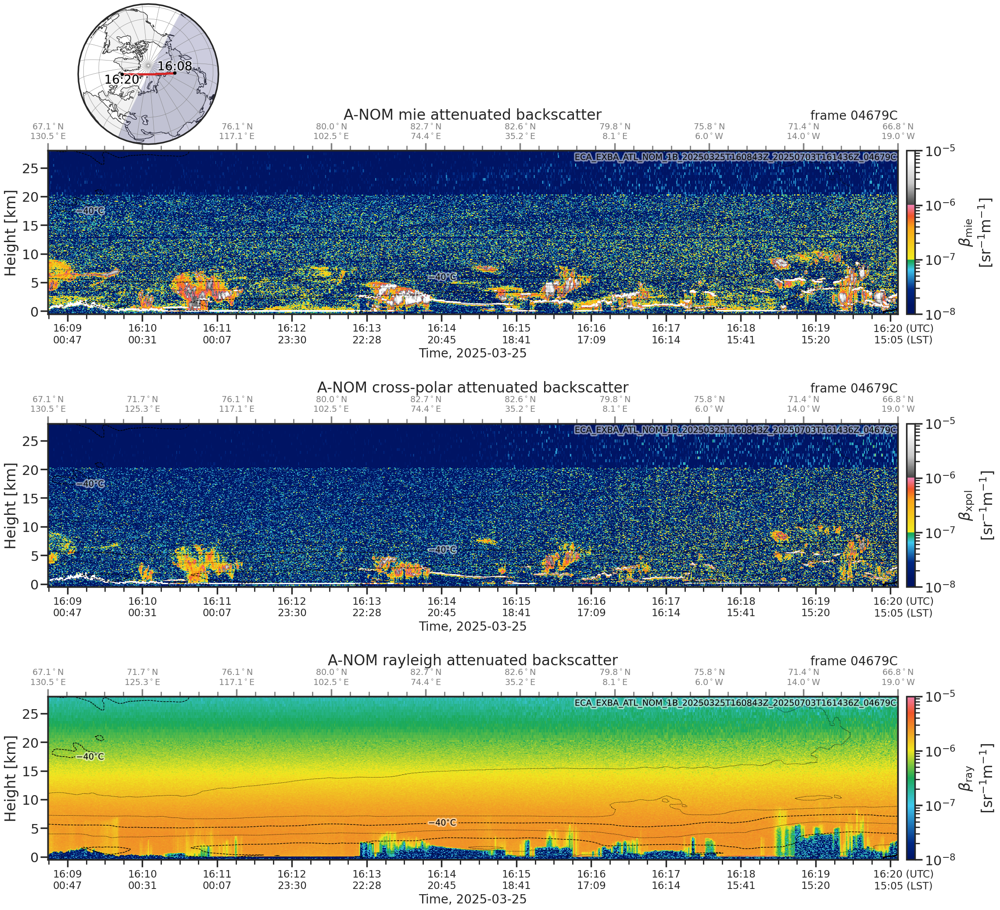

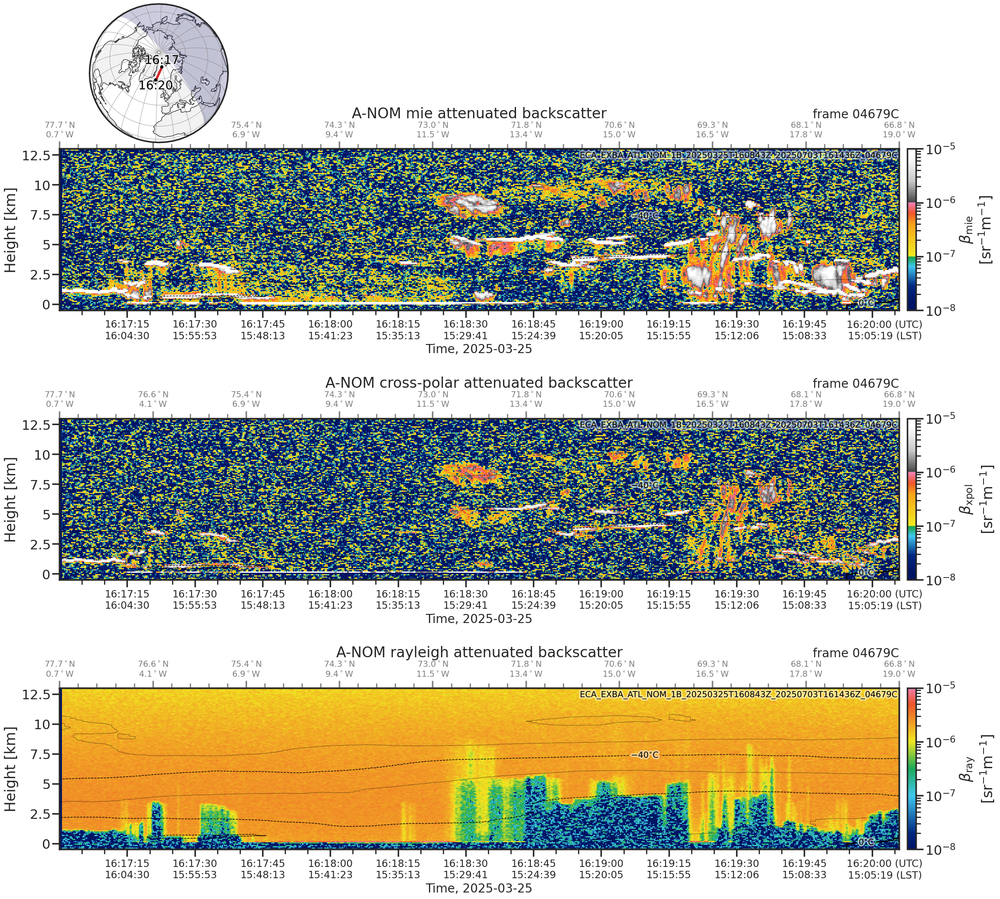

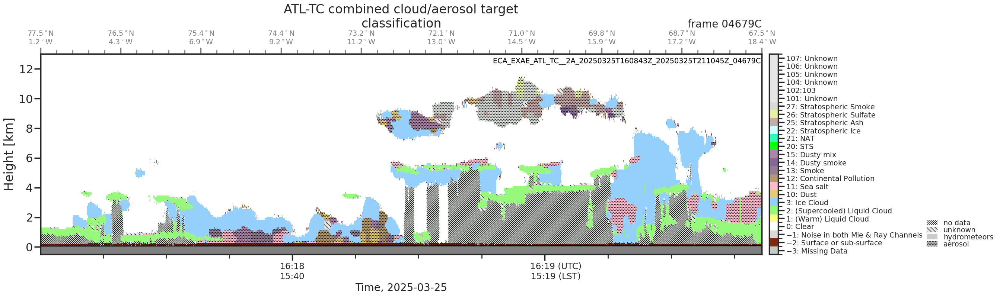

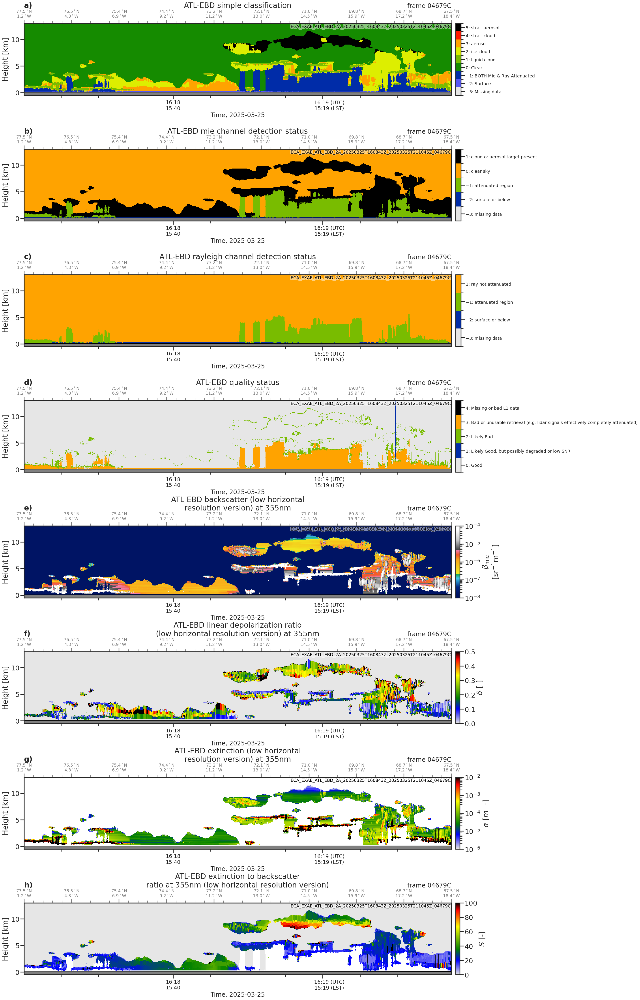

In [14]:
ANOM = ecio.load_ANOM(src2)

#print(ANOM)

cross=ANOM['crosspolar_attenuated_backscatter']
norm=(ANOM['crosspolar_normalised_signal'])

norm=norm.data
#print(norm[:,106])

from scipy.ndimage import gaussian_filter
ecplt.quicklook_ANOM(ANOM, dstdir=dstdir,hmax=28e3,smoother=dict(along_track=25), with_marble=True)#, prodmod_code="ECA_EXBA")

#plt.plot(norm[:,106])
#plt.plot(norm[:,105],color='r')
#plt.plot(norm[:,107],color='g')


#DNORM=2*(norm[:,106])-norm[:,105]-norm[:,107]cplt.quicklook_ATC(ATC, dstdir=dstdir)
#DMNORM=np.mean(DNORM)
#print(norm)
#print(DMNORM)
#plt.plot(DNORM)
#print(norm)

#AFM = ecio.load_AFM(srcdir)
#ecplt.quicklook_AFM(AFM, dstdir=dstdir,hmax=15e3)
#ATC = ecio.load_ATC(srcdir)
#ecplt.quicklook_ATC(ATC, dstdir=dstdir,hmax=15e3)
#NOM_zoom = ANOM.swap_dims({'along_track':'time'}).sel(time=slice('2025-04-30 14:37:55', '2025-04-30 14:38:35')).swap_dims({'time':'along_track'})
#ecplt.quicklook_ANOM(NOM_ZOOM, dstdir=dstdir,hmax=15e3,smoother=dict(along_track=25), with_marble=True)#, prodmod_code="ECA_EXBA")
if orbit_sequence=='05238D':
    NOM_zoom = ANOM.swap_dims({'along_track':'time'}).sel(time=slice('2025-04-30 14:37:45', '2025-04-30 14:38:35')).swap_dims({'time':'along_track'})
    ecplt.quicklook_ANOM(NOM_zoom, dstdir=dstdir,hmax=15e3,smoother=dict(along_track=30),short_timestep=True)#, prodmod_code="ECA_EXBA")
    AFM_zoom = AFM.swap_dims({'along_track':'time'}).sel(time=slice('2025-04-30 14:37:45', '2025-04-30 14:38:35')).swap_dims({'time':'along_track'})
    ecplt.quicklook_AFM(AFM_zoom, dstdir=dstdir,hmax=15e3, short_timestep=True)#, prodmod_code="ECA_EXBA")
    ATC_zoom = ATC.swap_dims({'along_track':'time'}).sel(time=slice('2025-04-30 14:37:45', '2025-04-30 14:38:35')).swap_dims({'time':'along_track'})
    #ecplt.quicklook_ATC(ATC, dstdir=dstdir,hmax=15e3)
if orbit_sequence=='07302A':
    AFM = ecio.load_AFM(srcdir)
    NOM_zoom = ANOM.swap_dims({'along_track':'time'}).sel(time=slice('2025-09-10 05:40:00', '2025-09-10 05:41:15')).swap_dims({'time':'along_track'})
    ecplt.quicklook_ANOM(NOM_zoom, dstdir=dstdir,hmax=15e3,smoother=dict(along_track=5),short_timestep=True)#, prodmod_code="ECA_EXBA")
    AFM_zoom = AFM.swap_dims({'along_track':'time'}).sel(time=slice('2025-09-10 05:40:00', '2025-09-10 05:41:15')).swap_dims({'time':'along_track'})
    print(AFM_zoom['time'][0])    
    #stop
    ecplt.quicklook_AFM(AFM_zoom, dstdir=dstdir,hmax=15e3, short_timestep=True)#, prodmod_code="ECA_EXBA")
#    ATC_zoom = ATC.swap_dims({'along_track':'time'}).sel(time=slice('2025-04-30 14:37:45', '2025-04-30 14:38:35')).swap_dims({'time':'along_track'})
    #ecplt.quicklook_ATC(ATC, dstdir=dstdir,hmax=15e3)
    #pritn
    fm=np.array(AFM_zoom['featuremask'])
    mie=np.array(NOM_zoom['mie_attenuated_backscatter'])
    print(np.shape(mie))
    print(np.shape(fm))
    
    mask  = (fm == 10)
    mask2 = (fm > 5) & (fm < 10)
    fig, ax = plt.subplots(figsize=(25,5))
    plt.scatter(fm[mask],  np.log10(mie[mask]),  color='r', label='fm == 10')
    plt.scatter(fm[mask2], np.log10(mie[mask2]), color='b', label='5 < fm < 10')
    plt.legend()
    plt.ylim(-8,-3)
    plt.xlabel("Feature mask")
    plt.ylabel("Mie attenuated backscatter")
    plt.show()#mie=NOM_zoom['mie_attenuated_backscatter']
    plt.close()
    fm_values = [5,6,7,8,9,10]

    plt.figure(figsize=(7,5))
    
    for v in fm_values:
        mask = (fm == v)
        plt.hist(np.log10(mie[mask]), bins=80, alpha=0.5, label=f'fm = {v}', density=False)
    
    plt.xlabel('Mie Attenuated Backscatter')
    plt.ylabel('Counts')
    plt.legend()
    plt.title('1D Histograms of Mie Backscatter for Different Feature Mask Values')
    plt.show()

    plt.figure(figsize=(7,5))
    
    for v in fm_values:
        mask = (fm == v)
        data = mie[mask]
    # Select data inside desired range
        dmin, dmax = 1e-8, 1e-3
        data_sel = data[(data >= dmin) & (data <= dmax)]
        
        # Create 90 log-spaced bins
        bins = np.logspace(np.log10(dmin), np.log10(dmax), 91)
        
        # Histogram in log space
        counts, bins = np.histogram(data_sel, bins=bins)
        # Compute histogram
        #counts, bins = np.histogram(data, bins=90)
    
        # Normalize so max(counts)==1
        if counts.max() > 0:
            counts = counts / counts.max()
    
        # Plot
        bin_centers = 0.5*(bins[:-1] + bins[1:])
   #     plt.plot(bin_centers, counts, label=f'fm={v}')
        plt.step(np.log10(bins[:-1]), counts, where='post', label=f'fm={v}')

    plt.xlabel('Mie Attenuated Backscatter')
    plt.ylabel('Relative Occurrence (max = 1)')
    plt.title('1D Histograms Normalized by Maximum Occurrence')
    #plt.legend()
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    plt.grid(True)
    plt.show()
if orbit_sequence=='07302B':
    NOM_zoom = ANOM.swap_dims({'along_track':'time'}).sel(time=slice('2025-09-10 05:41:35', '2025-09-10 05:44:00')).swap_dims({'time':'along_track'})
    ecplt.quicklook_ANOM(NOM_zoom, dstdir=dstdir,hmax=20e3,smoother=dict(along_track=15),short_timestep=True)#, prodmod_code="ECA_EXBA")
    #ecplt.quicklook_ANOM(NOM_zoom, dstdir=dstdir,hmax=16e3,smoother=dict(along_track=5),short_timestep=True)#, prodmod_code="ECA_EXBA")
    #fig, axes = ecplt.plot_ECL1_MSI_TIR(MRGR_zoom,dh=6)
    #fig.savefig(f"{dstdir}/{MRGR_zoom.encoding['source'].split('/')[-1].split('.')[0]}_zoom_TIR.png", bbox_inches='tight')

if orbit_sequence=='09325H':
    NOM_zoom = ANOM.swap_dims({'along_track':'time'}).sel(time=slice('2026-01-18 07:18:30', '2026-01-18 07:21:00')).swap_dims({'time':'along_track'})
    ecplt.quicklook_ANOM(NOM_zoom, dstdir=dstdir,hmax=13e3,smoother=dict(along_track=15),short_timestep=True, with_marble=True)#, prodmod_code="ECA_EXBA")

if orbit_sequence=='04679C':
    NOM_zoom = ANOM.swap_dims({'along_track':'time'}).sel(time=slice('2025-03-25 16:17:00', '2025-03-25 16:20:05')).swap_dims({'time':'along_track'})
    ecplt.quicklook_ANOM(NOM_zoom, dstdir=dstdir,hmax=13e3,smoother=dict(along_track=15),short_timestep=True, with_marble=True)#, prodmod_code="ECA_EXBA")
    ATC = ecio.load_ATC(srcdir)
    ATC_zoom = ATC.swap_dims({'along_track':'time'}).sel(time=slice('2025-03-25 16:17:00', '2025-03-25 16:20:05')).swap_dims({'time':'along_track'})
    ecplt.quicklook_ATC(ATC_zoom, dstdir=dstdir,hmax=13e3)
    AEBD = ecio.load_AEBD(srcdir)
    AEBD_zoom = AEBD.swap_dims({'along_track':'time'}).sel(time=slice('2025-03-25 16:17:00', '2025-03-25 16:20:05')).swap_dims({'time':'along_track'})
    ecplt.quicklook_AEBD(AEBD_zoom, resolution='low', dstdir=dstdir,hmax=13e3)

if orbit_sequence=='09333E':
    NOM_zoom = ANOM.swap_dims({'along_track':'time'}).sel(time=slice('2026-01-18 19:06:00', '2026-01-18 19:13:00')).swap_dims({'time':'along_track'})
    ecplt.quicklook_ANOM(NOM_zoom, dstdir=dstdir,hmax=13e3,smoother=dict(along_track=15),short_timestep=True, with_marble=True)#, prodmod_code="ECA_EXBA")

if orbit_sequence=='06708D':
    NOM_zoom = ANOM.swap_dims({'along_track':'time'}).sel(time=slice('2025-08-03 01:56:45', '2025-08-03 01:58:45')).swap_dims({'time':'along_track'})
    ecplt.quicklook_ANOM(NOM_zoom, dstdir=dstdir,hmax=5e3,smoother=dict(along_track=5),short_timestep=True, with_surface=True)#, prodmod_code="ECA_EXBA")
    MRGR = ecio.load_MRGR(src2)
    MRGR_zoom = MRGR.swap_dims({'along_track':'time'}).sel(time=slice('2025-08-03 01:56:45', '2025-08-03 01:58:45')).swap_dims({'time':'along_track'})
    ecplt.quicklook_MRGR(MRGR_zoom,dh=6, hspace=1.5)
    AFM = ecio.load_AFM(srcdir)
    AFM_zoom = AFM.swap_dims({'along_track':'time'}).sel(time=slice('2025-08-03 01:56:45', '2025-08-03 01:58:45')).swap_dims({'time':'along_track'})
    ecplt.quicklook_AFM(AFM_zoom, dstdir=dstdir,hmax=5e3, short_timestep=True)#, prodmod_code="ECA_EXBA")
    ATC = ecio.load_ATC(srcdir)
    ATC_zoom = ATC.swap_dims({'along_track':'time'}).sel(time=slice('2025-08-03 01:56:45', '2025-08-03 01:58:45')).swap_dims({'time':'along_track'})
    ecplt.quicklook_ATC(ATC_zoom, dstdir=dstdir,hmax=5e3)
    #ecplt.quicklook_ANOM(NOM_zoom, dstdir=dstdir,hmax=16e3,smoother=dict(along_track=5),short_timestep=True)#, prodmod_code="ECA_EXBA")

if orbit_sequence=='08108B':
    NOM_zoom = ANOM.swap_dims({'along_track':'time'}).sel(time=slice('2025-11-01 01:00:00', '2025-11-01 01:02:00')).swap_dims({'time':'along_track'})
    ecplt.quicklook_ANOM(NOM_zoom, dstdir=dstdir,hmax=16e3,smoother=dict(along_track=5),short_timestep=True)#, prodmod_code="ECA_EXBA")
    AFM_zoom = AFM.swap_dims({'along_track':'time'}).sel(time=slice('2025-11-01 01:00:00', '2025-11-01 01:02:00')).swap_dims({'time':'along_track'})
    ecplt.quicklook_AFM(AFM_zoom, dstdir=dstdir,hmax=16e3, short_timestep=True)#, prodmod_code="ECA_EXBA")
    
    ATC_zoom = ATC.swap_dims({'along_track':'time'}).sel(time=slice('2025-11-01 01:00:00', '2025-11-01 01:02:00')).swap_dims({'time':'along_track'})
    ecplt.quicklook_ATC(ATC_zoom, dstdir=dstdir,hmax=16e3)

2 EarthCARE product files match path /net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/EC_tools_only/Working_DIR//ECA_EX[A-Z][A-Z]_ATL_FM__2A_*_*_*/ECA_EX[A-Z][A-Z]_ATL_FM__2A_*_*_*.h5; selecting -1
Selecting frame from 173 to 17100


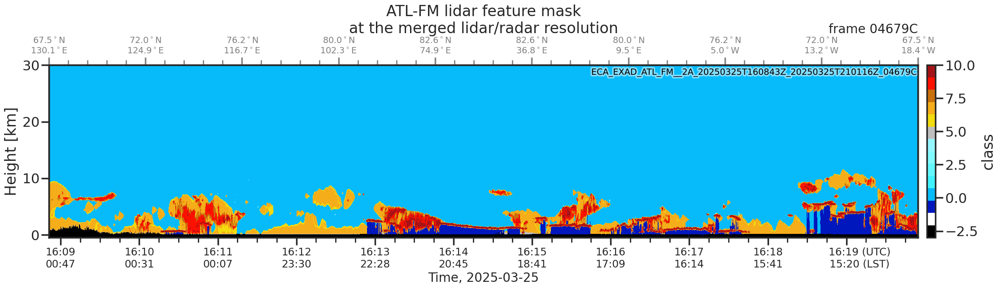

In [15]:
AFM = ecio.load_AFM(srcdir)
ecplt.quicklook_AFM(AFM, dstdir=dstdir,hmax=30e3)

#print(np.array(AFM['mie_noise'])/np.array(AFM['mie_noise_error']))
#print(np.mean(np.array(AFM['sigma0_rayleigh'])/np.array(AFM['sigma_rayleigh_error'])))
#print(np.array(AFM['cross_noise'])/np.array(AFM['cross_noise_error']))


In [25]:
if orbit_sequence=='08108B':
    AEBD = ecio.load_AEBD(srcdir)
    AEBD_zoom = AEBD.swap_dims({'along_track':'time'}).sel(time=slice('2025-11-01 01:00:00', '2025-11-01 01:02:00')).swap_dims({'time':'along_track'})
    ecplt.quicklook_AEBD(AEBD_zoom, resolution='low', dstdir=dstdir,hmax=15e3)

Selecting frame from 99 to 4745
Selecting frame from 99 to 4745


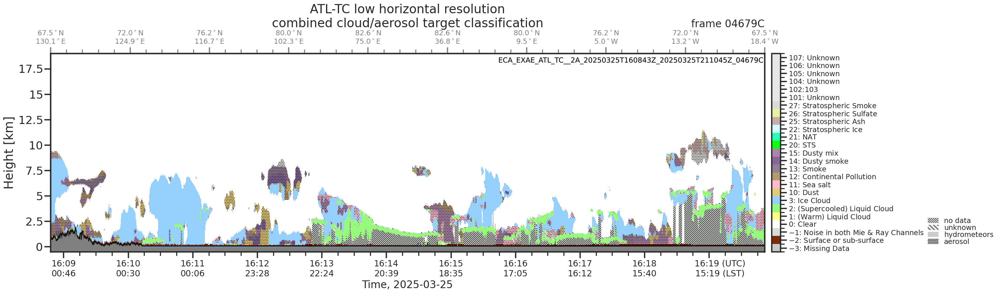

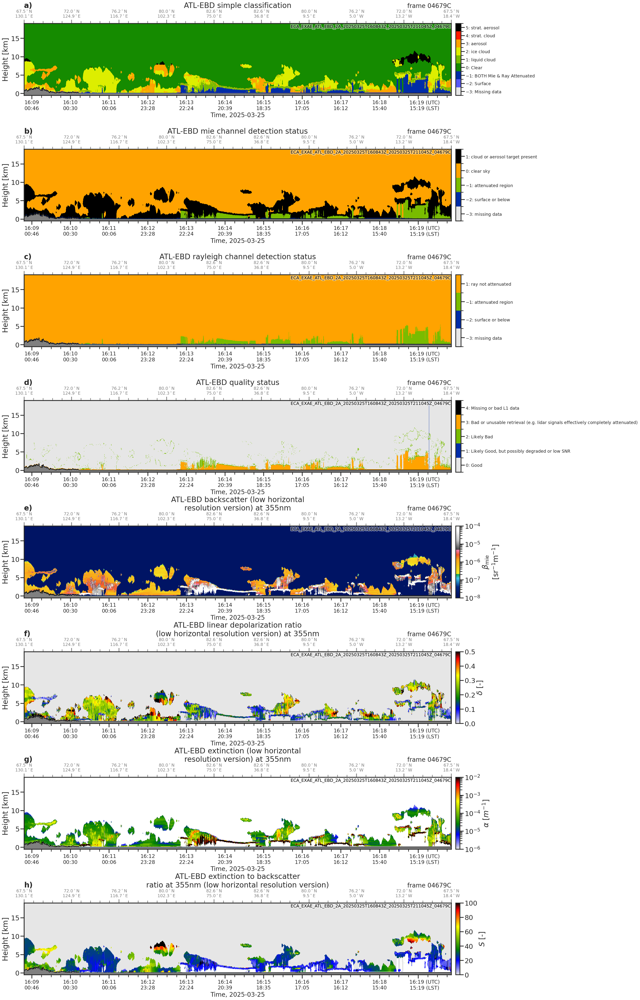

In [10]:
ATC = ecio.load_ATC(srcdir)
ecplt.quicklook_ATC(ATC, resolution='low', dstdir=dstdir, hmax=19.e3)#,show_temperature=True) 
AEBD = ecio.load_AEBD(srcdir)
ecplt.quicklook_AEBD(AEBD, resolution='low', dstdir=dstdir,hmax=19.e3)#,show_temperature=True)

No EarthCARE product files match path /net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/EC_tools_only/Working_DIR//ECA_EX[A-Z][A-Z]_MSI_RGR_1C_*_*_*/ECA_EX[A-Z][A-Z]_MSI_RGR_1C_*_*_*.h5.


AttributeError: 'NoneType' object has no attribute 'encoding'

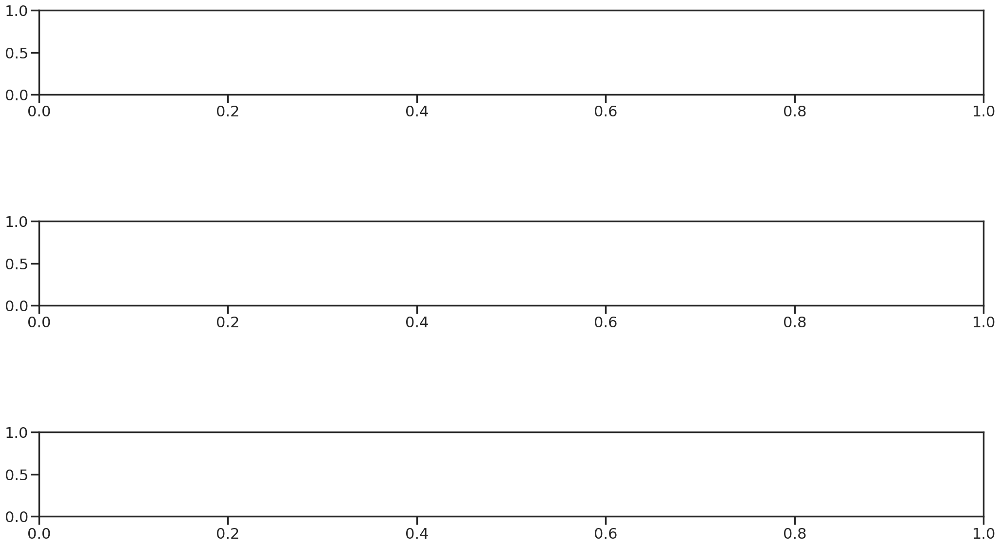

In [11]:
MRGR = ecio.load_MRGR(src2)

if orbit_sequence=='07302B':
    MRGR_zoom = MRGR.swap_dims({'along_track':'time'}).sel(time=slice('2025-09-10 05:41:35', '2025-09-10 05:44:00')).swap_dims({'time':'along_track'})
    #ecplt.quicklook_ANOM(NOM_zoom, dstdir=dstdir,hmax=16e3,smoother=dict(along_track=5),short_timestep=True)#, prodmod_code="ECA_EXBA")
    fig, axes = ecplt.plot_ECL1_MSI_TIR(MRGR_zoom,dh=6)
    fig.savefig(f"{dstdir}/{MRGR_zoom.encoding['source'].split('/')[-1].split('.')[0]}_zoom_TIR.png", bbox_inches='tight')

    fig, axes = ecplt.plot_ECL1_MSI_VNS(MRGR_zoom,dh=6)
    fig.savefig(f"{dstdir}/{MRGR_zoom.encoding['source'].split('/')[-1].split('.')[0]}_zoom_VNS.png", bbox_inches='tight')
     
    fig, axes= ecplt.quicklook_MRGR(MRGR_zoom,dh=6, hspace=1.5)
    fig.savefig(f"{dstdir}/{MRGR_zoom.encoding['source'].split('/')[-1].split('.')[0]}_quicklook_RGB.png", bbox_inches='tight')

#fig, axes = ecplt.plot_ECL1_MSI_extras(MRGR)
#fig.savefig(f"{dstdir}/{MRGR.encoding['source'].split('/')[-1].split('.')[0]}_quicklook_angles.png", bbox_inches='tight')

fig, axes = ecplt.plot_ECL1_MSI_TIR(MRGR)
fig.savefig(f"{dstdir}/{MRGR.encoding['source'].split('/')[-1].split('.')[0]}_quicklook_TIR.png", bbox_inches='tight')

fig, axes = ecplt.plot_ECL1_MSI_VNS(MRGR)
fig.savefig(f"{dstdir}/{MRGR.encoding['source'].split('/')[-1].split('.')[0]}_quicklook_VNS.png", bbox_inches='tight')


MRGR.close()



Selecting frame from 437 to 11649


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.007899960707694085..1.6081956128082688].


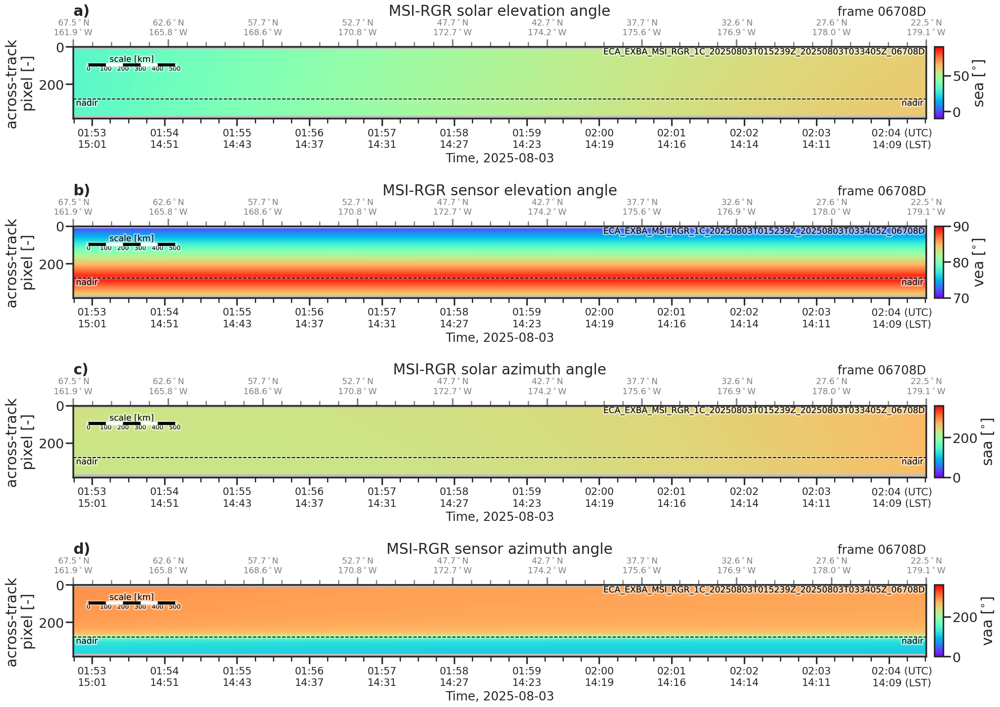

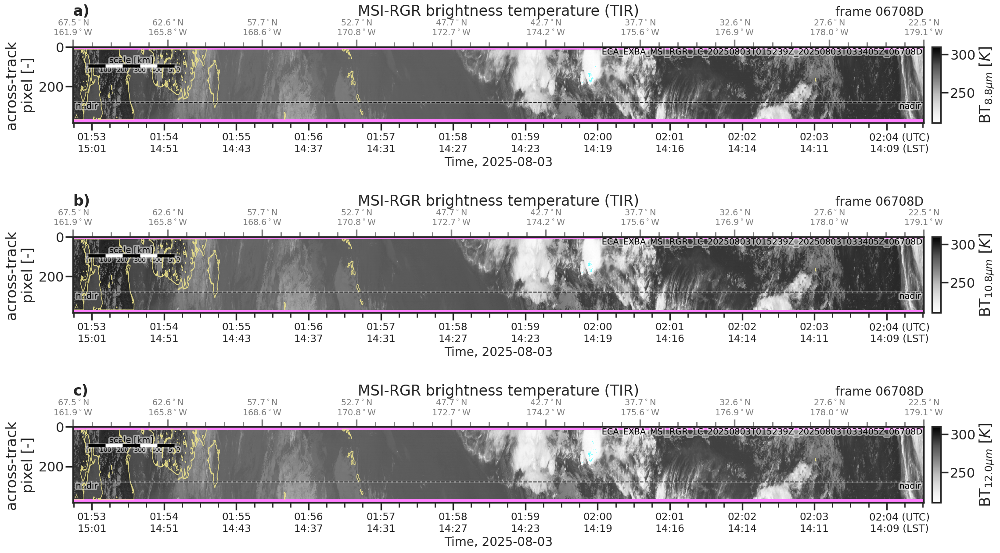

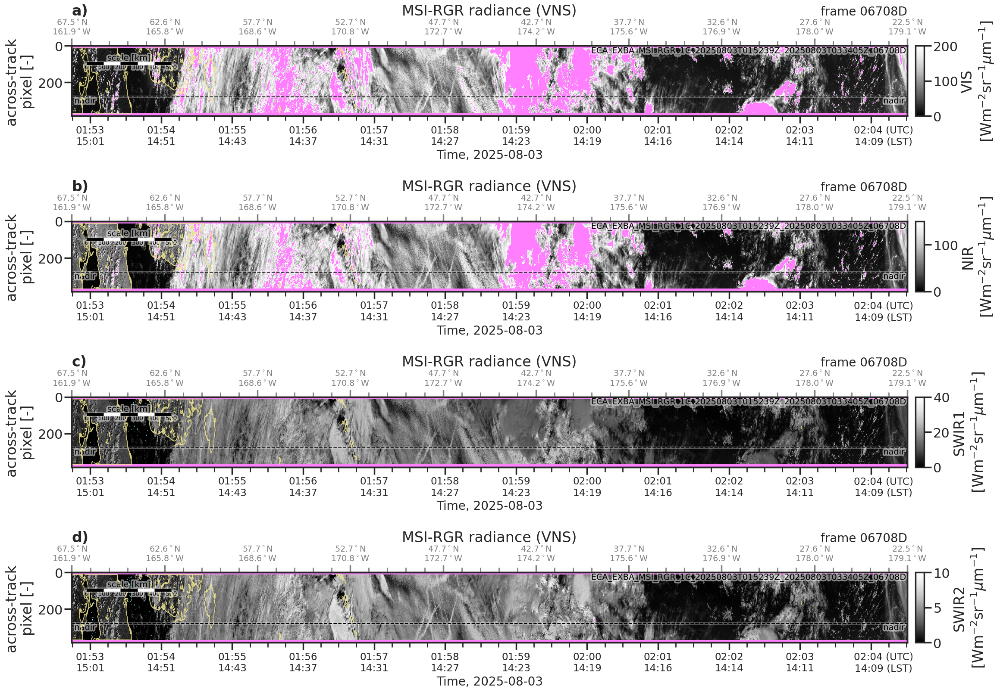

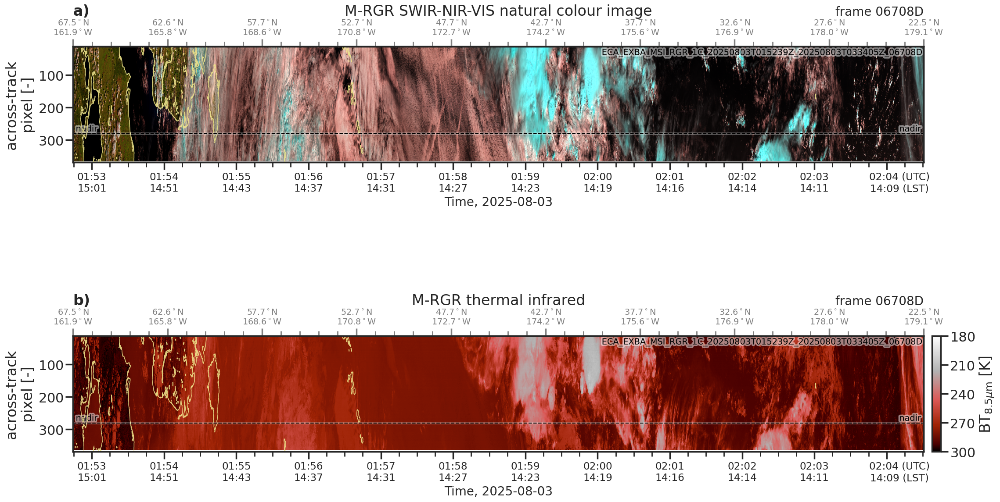

In [12]:
MRGR = ecio.load_MRGR(srcdir)


fig, axes = ecplt.plot_ECL1_MSI_extras(MRGR)
fig.savefig(f"{dstdir}/{MRGR.encoding['source'].split('/')[-1].split('.')[0]}_quicklook_angles.png", bbox_inches='tight')

fig, axes = ecplt.plot_ECL1_MSI_TIR(MRGR)
fig.savefig(f"{dstdir}/{MRGR.encoding['source'].split('/')[-1].split('.')[0]}_quicklook_TIR.png", bbox_inches='tight')

fig, axes = ecplt.plot_ECL1_MSI_VNS(MRGR)
fig.savefig(f"{dstdir}/{MRGR.encoding['source'].split('/')[-1].split('.')[0]}_quicklook_VNS.png", bbox_inches='tight')


fig, axes= ecplt.quicklook_MRGR(MRGR,dh=6, hspace=1.5)

fig.savefig(f"{dstdir}/{MRGR.encoding['source'].split('/')[-1].split('.')[0]}_quicklook_RGB.png", bbox_inches='tight')

MRGR.close()

2 EarthCARE product files match path /net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/EC_tools_only/Working_DIR//ECA_EX[A-Z][A-Z]_MSI_COP_2A_*_*_*/ECA_EX[A-Z][A-Z]_MSI_COP_2A_*_*_*.h5; selecting -1
Selecting frame from 425 to 10964


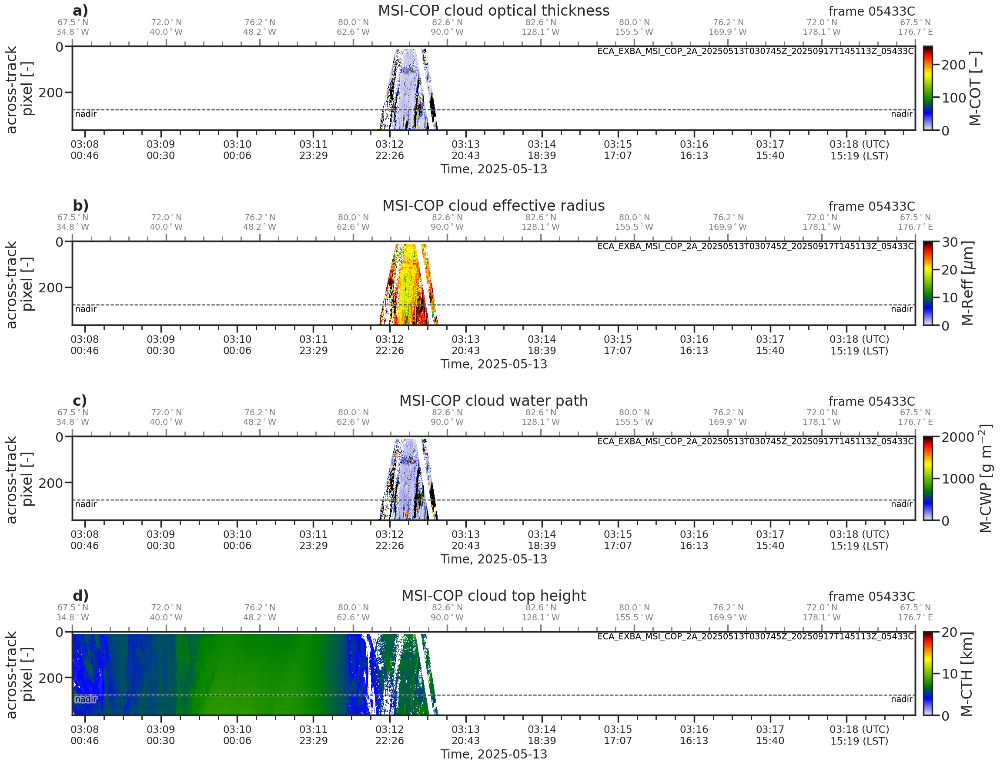

In [64]:
MCOP=ecio.load_MCOP(src2)
#fig, axes = ecplt.plot__TIR(MRGR)
fig, axes=ecplt.quicklook_MCOP(MCOP)
MCOP.close()

Selecting frame from 436 to 11649


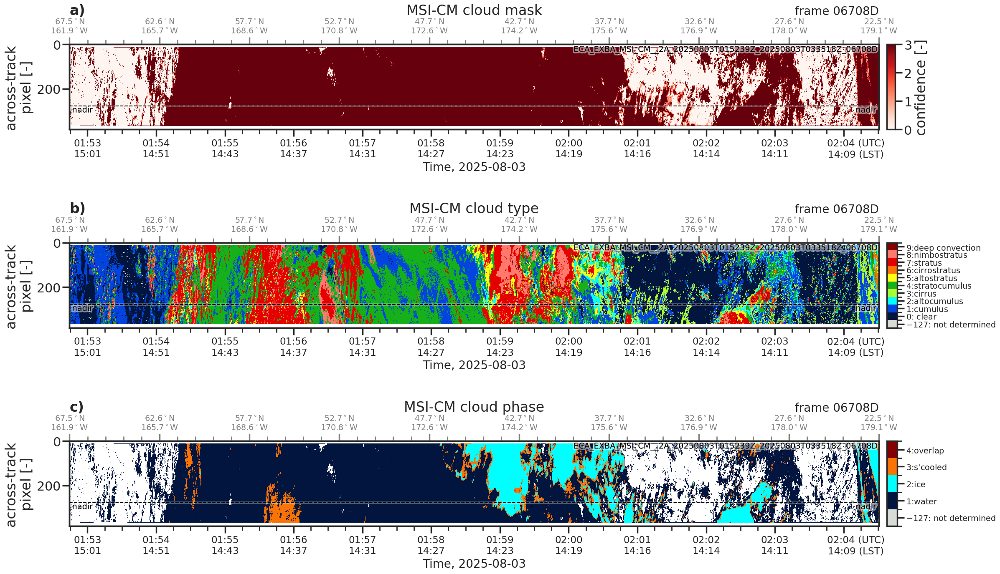

In [13]:
MCM = ecio.load_MCM(srcdir)

ecplt.quicklook_MCM(MCM, dstdir=dstdir)

MCM.close()

Selecting frame from 13 to 4959


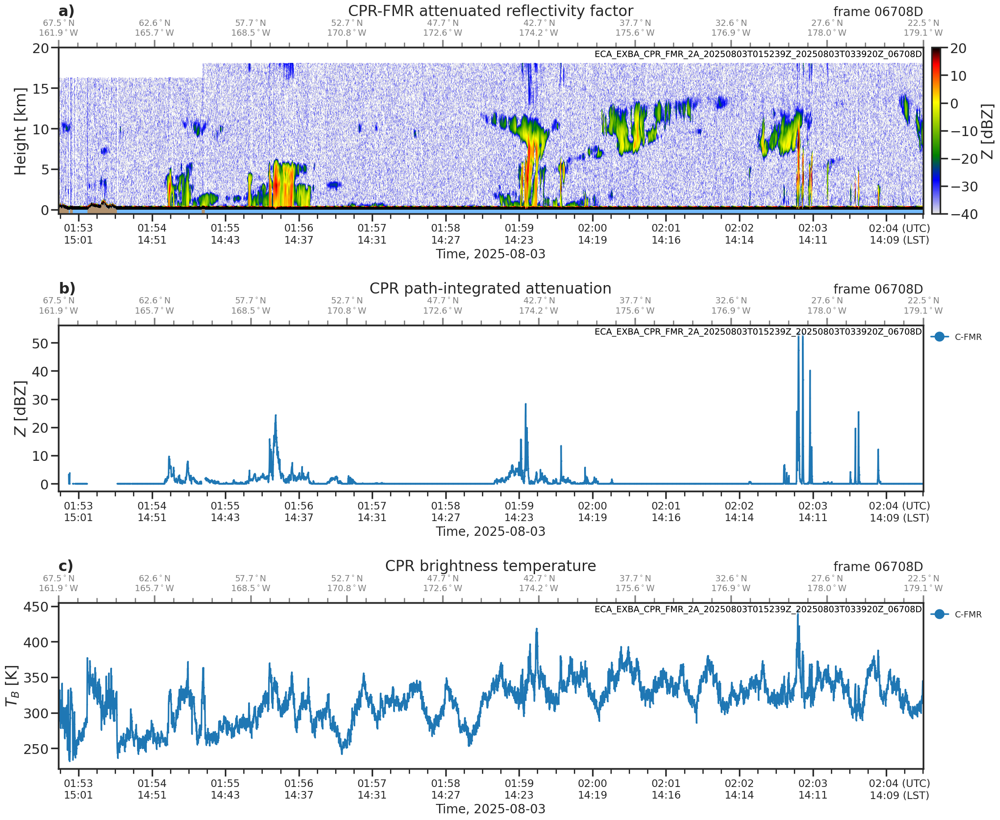

In [14]:
reload(ecplt)

CFMR = ecio.load_CFMR(src2)

ecplt.quicklook_CFMR(CFMR, dstdir=dstdir)

CFMR.close()

In [ ]:
CCD = ecio.load_CCD(src2)
#CCD = ecio.get_XMET(XMET, CCD, grid_heightdim='CPR_height
ecplt.quicklook_CCD(CCD, dstdir=dstdir)
#for ax in axes:
#    ecplt.add_temperature(ax, CCD)

CCD.close()

Selecting frame from 96 to 5042


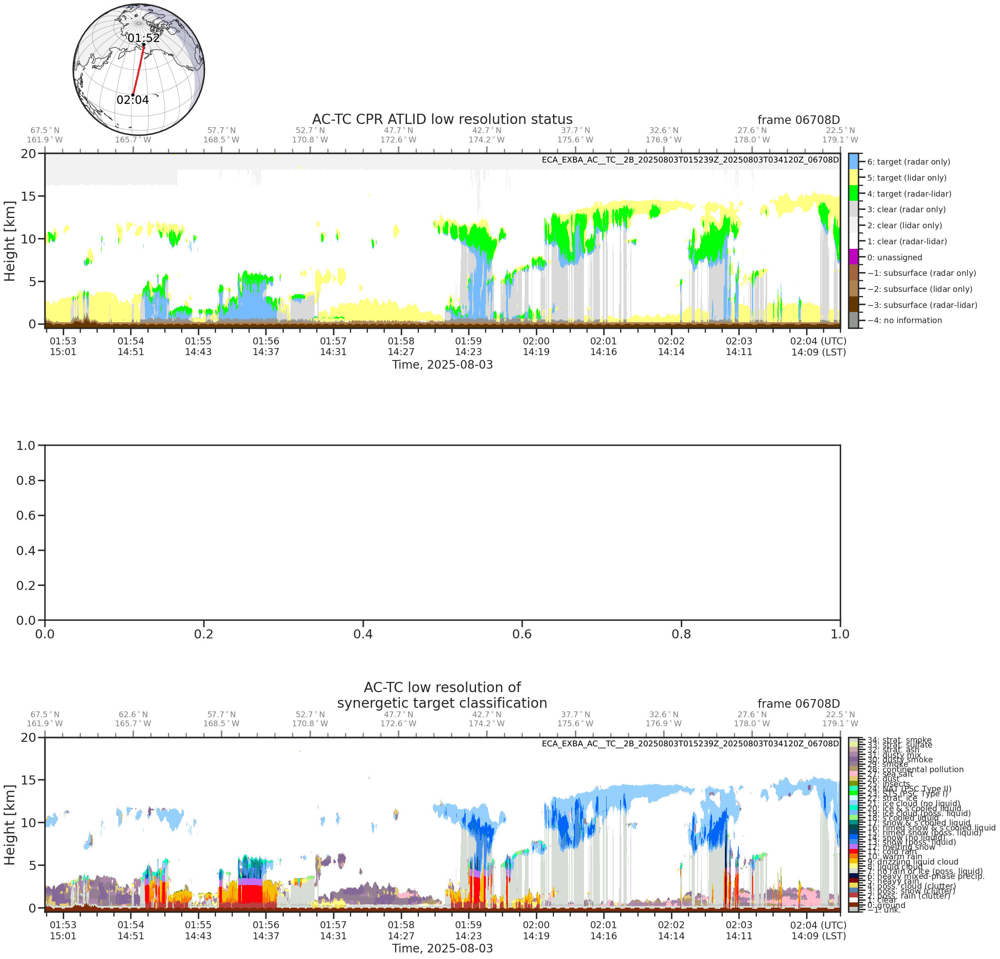

In [18]:
ACTC = ecio.load_ACTC(srcdir)

ecplt.quicklook_ACTC(ACTC, dstdir=dstdir, with_hatching=False,with_marble=True)

ACTC.close()

In [8]:
def plot_AEBD(AEBD):
    
    from ectools import colormaps
    reload(ecio)
    reload(ecplt)
    #reload(colormaps)
    import matplotlib.cm as cm

    hmax=25e3
#    cmap=colormaps.chiljet2()
    cmap = cm.get_cmap('chiljet2') 
    nrows=3
    fig, axes = plt.subplots(figsize=(25,7*nrows), nrows=nrows, 
                             sharex=False, sharey=False, gridspec_kw={'hspace':0.75})

    i=0
    ecplt.plot_EC_2D(axes[i], AEBD, 'lidar_ratio_355nm_medium_resolution', "s", 
              cmap=cmap, plot_scale='linear', plot_where=AEBD.particle_extinction_coefficient_355nm_medium_resolution > 0, 
              hmax=hmax, units='sr$^{-1}$', 
              plot_range=[0,120])


    i+=1
    ecplt.plot_EC_2D(axes[i], AEBD, 'particle_extinction_coefficient_355nm_medium_resolution', r"$\alpha$", 
              cmap=cmap, plot_scale='logarithmic', 
              hmax=hmax, units='m^${-1}$ sr$^{-1}$', 
              plot_range=[1e-8,1e-3])

    i+=1
    ecplt.plot_EC_2D(axes[i], AEBD, 'particle_linear_depol_ratio_355nm_medium_resolution', r"$\delta$", 
              cmap=cmap, plot_scale='linear', plot_where=AEBD.particle_extinction_coefficient_355nm_medium_resolution > 0, 
              hmax=hmax, units='-', 
              plot_range=[0,1])

    ecplt.add_subfigure_labels(axes, yloc=1.2)
    ecplt.snap_xlims(axes)
    
    return fig, axes

Selecting frame from 97 to 5043


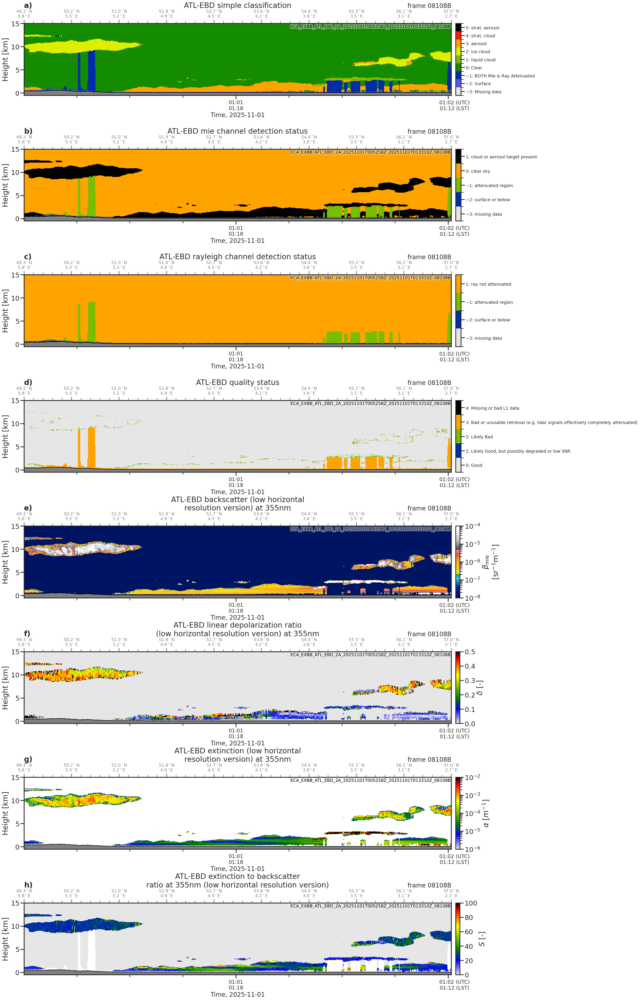

In [66]:
AEBD = ecio.load_AEBD(srcdir)
if orbit_sequence=='03508B':
    EBD_zoom = AEBD.swap_dims({'along_track':'time'}).sel(time=slice('2025-01-09 09:47:15', '2025-01-09 09:51:53')).swap_dims({'time':'along_track'})   
if orbit_sequence=='03539B':
    EBD_zoom = AEBD.swap_dims({'along_track':'time'}).sel(time=slice('2025-01-11 09:38:15', '2025-01-11 09:42:10')).swap_dims({'time':'along_track'})
if orbit_sequence=='03547D':
    EBD_zoom = AEBD.swap_dims({'along_track':'time'}).sel(time=slice('2025-01-11 22:28:50', '2025-01-11 22:33:00')).swap_dims({'time':'along_track'})
if orbit_sequence=='03516D':
    EBD_zoom = AEBD.swap_dims({'along_track':'time'}).sel(time=slice('2025-01-09 22:40:00', '2025-01-11 22:44:00')).swap_dims({'time':'along_track'})
if orbit_sequence=='05238D':
    EBD_zoom = AEBD.swap_dims({'along_track':'time'}).sel(time=slice('2025-04-30 14:37:45', '2025-04-30 14:38:35')).swap_dims({'time':'along_track'})

#fig, axes = plot_AEBD(AEBD)
#fig.savefig(f"{dstdir}/AEBD_{orbit_sequence}.png", bbox_inches='tight',dpi=300)

#print(EBD_zoom)
ecplt.quicklook_AEBD(EBD_zoom, resolution='low', dstdir=dstdir, hmax=15e3)
#ecplt.quicklook_AEBD(EBD_zoom, resolution='med', dstdir=dstdir,hmax=15e3)
#ecplt.quicklook_AEBD(AEBD, resolution='low', dstdir=dstdir)

AEBD.close()


In [24]:

AER = ecio.load_AAER(srcdir)
if orbit_sequence=='03508B':
    AER_zoom = AER.swap_dims({'along_track':'time'}).sel(time=slice('2025-01-09 09:47:15', '2025-01-09 09:51:53')).swap_dims({'time':'along_track'})   
if orbit_sequence=='03539B':
    AER_zoom = AER.swap_dims({'along_track':'time'}).sel(time=slice('2025-01-11 09:38:15', '2025-01-11 09:42:10')).swap_dims({'time':'along_track'})
if orbit_sequence=='03547D':
    AER_zoom = AER.swap_dims({'along_track':'time'}).sel(time=slice('2025-01-11 22:28:50', '2025-01-11 22:33:00')).swap_dims({'time':'along_track'})
if orbit_sequence=='03516D':
    AER_zoom = AER.swap_dims({'along_track':'time'}).sel(time=slice('2025-01-09 22:40:00', '2025-01-11 22:44:00')).swap_dims({'time':'along_track'})


#AER = ecio.load_AAER(srcdir)
fig, axes = plot_AER(AER_zoom)
fig.savefig(f"{dstdir}/AER_{orbit_sequence}.png", bbox_inches='tight',dpi=300)

Selecting frame from 96 to 5042


NameError: name 'plot_AER' is not defined

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image

AFM = ecio.load_AFM(srcdir)

if orbit_sequence=='03508B':
   image_path = "snapshot-2025-01-09T09_50_00Z.jpg"
if orbit_sequence=='03539B':
   image_path = "snapshot-2025-01-11T09_45_00Z.jpg" 
if orbit_sequence=='03547D':
    image_path = "snapshot-2025-01-11T22_30_00Z.jpg"
if orbit_sequence=='03516D':
    image_path == "snapshot-2025-01-09T22_40_00Z.jpg"
   



# Path to your image file
#image_path = "snapshot-2025-01-11T00_00_00Z.jpg"  # Replace with your image path

# Latitude and longitude bounding box values
#lat_min, lat_max = -90, 90  # Replace with your latitude range
#lon_min, lon_max = -180, 180  # Replace with your longitude range
lat_min = 10
lat_max = 50
lon_min = -140
lon_max = -100
# Read the image using Pillow
image = Image.open(image_path)

# Plot the image with bounding box
fig, ax = plt.subplots(figsize=(10, 8))
extent = [lon_min, lon_max, lat_min, lat_max]  # Define the bounding box [lon_min, lon_max, lat_min, lat_max]
ax.imshow(image, extent=extent, origin='upper')

# Add labels
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
#ax.set_title("Image with Latitude/Longitude Bounding Box")

filtered_AFM = AFM.where(
    (AFM["longitude"] >= lon_min) & (AFM["longitude"] <= lon_max) &
    (AFM["latitude"] >= lat_min) & (AFM["latitude"] <= lat_max),
    drop=True
)

ax.plot(filtered_AFM["longitude"],filtered_AFM["latitude"])
ax.set_ylim(20,50)


fig.savefig(f"{dstdir}/{orbit_sequence}_earthdata.png", bbox_inches='tight',dpi=300)
plt.show()

Selecting frame from 562 to 4978


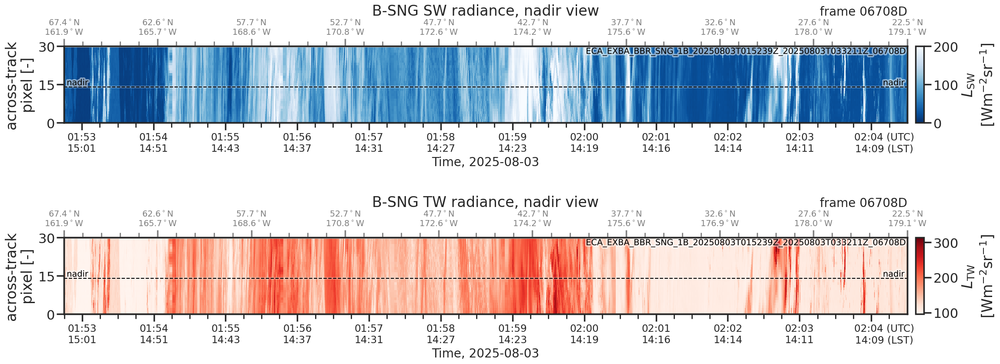

In [23]:
BSNG = ecio.load_BSNG(srcdir, 
                      product_code="BBR_SNG_1B", group='ScienceData', i=-1, trim=True)

ecplt.quicklook_BSNG(BSNG, dstdir=dstdir)

BSNG.close()

In [11]:
import matplotlib.pyplot as plt
from PIL import Image

AFM = ecio.load_AFM(srcdir)

if orbit_sequence=='03508B':
   image_path = "snapshot-2025-01-09T09_50_00Z.jpg"
if orbit_sequence=='03539B':
   image_path = "snapshot-2025-01-11T09_45_00Z.jpg" 
if orbit_sequence=='03547D':
    image_path = "snapshot-2025-01-11T22_30_00Z.jpg"
if orbit_sequence=='03516D':
    image_path == "snapshot-2025-01-09T22_40_00Z.jpg"
   



# Path to your image file
#image_path = "snapshot-2025-01-11T00_00_00Z.jpg"  # Replace with your image path

# Latitude and longitude bounding box values
#lat_min, lat_max = -90, 90  # Replace with your latitude range
#lon_min, lon_max = -180, 180  # Replace with your longitude range
lat_min = 10
lat_max = 50
lon_min = -140
lon_max = -100
# Read the image using Pillow
image = Image.open(image_path)

# Plot the image with bounding box
fig, ax = plt.subplots(figsize=(10, 8))
extent = [lon_min, lon_max, lat_min, lat_max]  # Define the bounding box [lon_min, lon_max, lat_min, lat_max]
ax.imshow(image, extent=extent, origin='upper')

# Add labels
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
#ax.set_title("Image with Latitude/Longitude Bounding Box")

filtered_AFM = AFM.where(
    (AFM["longitude"] >= lon_min) & (AFM["longitude"] <= lon_max) &
    (AFM["latitude"] >= lat_min) & (AFM["latitude"] <= lat_max),
    drop=True
)

ax.plot(filtered_AFM["longitude"],filtered_AFM["latitude"])
ax.set_ylim(20,50)


fig.savefig(f"{dstdir}/{orbit_sequence}_earthdata.png", bbox_inches='tight',dpi=300)
plt.show()

2 EarthCARE product files match path /net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/EC_tools_only/Working_DIR//ECA_EX[A-Z][A-Z]_ATL_FM__2A_*_*_*/ECA_EX[A-Z][A-Z]_ATL_FM__2A_*_*_*.h5; selecting -1


RuntimeError: NetCDF: HDF error

In [ ]:
ANOM

In [12]:
# Assuming you have already found the first matching time index
time_ANOM = ANOM['time'].values
time_AFM = AFM['time'].values
print(np.size(time_ANOM))
print(np.size(time_AFM))
# Find common times between both datasets
common_times = np.intersect1d(time_ANOM, time_AFM)

# Ensure there are common times
if common_times.size > 0:
    # First and last common times
    first_common_time = common_times[0]
    last_common_time = common_times[-1]

    # Find indices for the first and last common times in both datasets
    index_first_ANOM = np.where(time_ANOM == first_common_time)[0][0]
    index_last_ANOM = np.where(time_ANOM == last_common_time)[0][0]

    index_first_AFM = np.where(time_AFM == first_common_time)[0][0]
    index_last_AFM = np.where(time_AFM == last_common_time)[0][0]

    # Slice both datasets to only include data between the first and last common time
    #ANOM_sliced = ANOM.isel(time=slice(index_first_ANOM, index_last_ANOM + 1))
    #AFM_sliced = AFM.isel(time=slice(index_first_AFM, index_last_AFM + 1))
    print(f"First common time: {first_common_time}")
    print(f"Index in ANOM: {index_first_ANOM}")
    print(f"Index in AFM: {index_first_AFM}")

    print(f"Last common time: {last_common_time}")
    print(f"Index in ANOM: {index_last_ANOM}; {index_last_ANOM-index_first_ANOM}")
    print(f"Index in AFM: {index_last_AFM}; {index_last_AFM-index_first_AFM}")

    # Align the datasets based on the sliced data
    #ANOM_aligned, AFM_aligned = xr.align(ANOM_sliced, AFM_sliced, join='inner')

    print("Datasets aligned between first and last common times.")
else:
    print("No common times found between the datasets.")

18482
18015
First common time: 2025-04-30T14:32:40.082135936
Index in ANOM: 177
Index in AFM: 0
Last common time: 2025-04-30T14:44:26.530210048
Index in ANOM: 18191; 18014
Index in AFM: 18014; 18014
Datasets aligned between first and last common times.


In [13]:
ANOM_sliced = ANOM.isel(along_track=slice(index_first_ANOM, index_last_ANOM + 1))
AFM_sliced = AFM.isel(along_track=slice(index_first_AFM, index_last_AFM + 1))
# Align the datasets based on the sliced data
ANOM_aligned, AFM_aligned = xr.align(ANOM_sliced, AFM_sliced, join='inner')

In [14]:
ANOM_aligned


<xarray.Dataset> Size: 586MB
Dimensions:                                                         (
                                                                     along_track: 18015,
                                                                     height_raw: 256,
                                                                     background: 2,
                                                                     height: 254,
                                                                     segments: 6)
Coordinates:
  * along_track                                                     (along_track) int64 144kB ...
Dimensions without coordinates: height_raw, background, height, segments
Data variables: (12/134)
    mie_raw_signal                                                  (along_track, height_raw) uint16 9MB ...
    rayleigh_raw_signal                                             (along_track, height_raw) uint16 9MB ...
    crosspolar_raw_signal                                           (along_track, height_raw) uint16 9MB ...
    mie_offset                                                      float32 4B ...
    rayleigh_offset                                                 float32 4B ...
    crosspolar_offset                                               float32 4B ...
    ...                                                              ...
    hot_pixel_level_rayleigh                                        (height) float32 1kB ...
    hot_pixel_level_mie                                             (height) float32 1kB ...
    hot_pixel_level_crosspolar                                      (height) float32 1kB ...
    geoid_offset                                                    (along_track) float32 72kB ...
    latitude                                                        (along_track) float64 144kB ...
    longitude                                                       (along_track) float64 144kB ...

In [15]:
print(ANOM_sliced['time'][-1])
print(AFM_sliced['time'][-1])

<xarray.DataArray 'time' ()> Size: 8B
array('2025-04-30T14:44:26.530210048', dtype='datetime64[ns]')
Coordinates:
    along_track  int64 8B 18191
Attributes:
    long_name:  Time
<xarray.DataArray 'time' ()> Size: 8B
array('2025-04-30T14:44:26.530210048', dtype='datetime64[ns]')
Coordinates:
    along_track  int64 8B 18191
Attributes:
    long_name:  Time in seconds since January 1st 2000


ValueError: Dimensions {'ATLID_height'} do not exist. Expected one or more of FrozenMappingWarningOnValuesAccess({'along_track': 18015, 'height': 254})

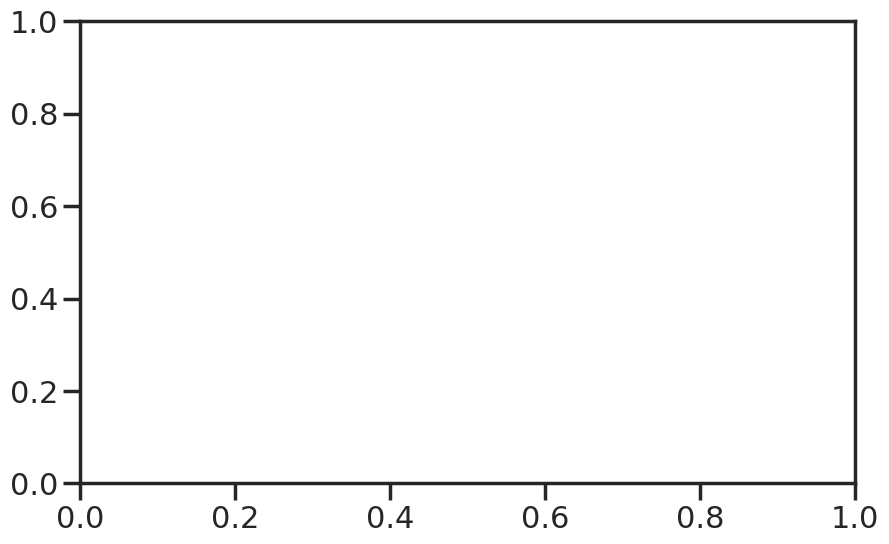

In [16]:
# Assuming AFM and ANOM are xarray Datasets
# Align the datasets (assuming they share dimensions like time or height)

# Unique featuremask values we are interested in
featuremask_values = [-3,-2,-1,0,1, 2, 3, 4, 5, 6, 7, 8, 9, 10]  # adjust as needed

mie=ANOM_sliced['mie_attenuated_backscatter']
mie = mie.where(mie >= 1.e-10, 1.e-10)

#mie = np.where(mie < 1.e-10, 1.e-10, mie)
height = ANOM_sliced['height']
mie_aligned, height_aligned = xr.align(mie, height, join='inner')

#mie=np.log10(mie)
mie_log10 = xr.DataArray(np.log10(mie.values), dims=mie.dims, coords=mie.coords)
# Prepare the plot
fig, ax = plt.subplots(figsize=(10, 6))

# Loop over featuremask values and plot histograms
for featuremask_value in featuremask_values:
    # Filter the featuremask and corresponding Mie data
    filtered_mie_data = mie_log10.where(AFM_sliced['featuremask'] == featuremask_value, drop=True)
    
    # Remove NaN values
    filtered_mie_data = filtered_mie_data.where(~np.isnan(filtered_mie_data), drop=True)

    # Flatten the data and plot the histogram
    if filtered_mie_data.size > 0:  # Check if there's data for this featuremask
        ax.hist(filtered_mie_data.values.flatten(), bins=50, alpha=0.5, label=f'Featuremask = {featuremask_value}')

# Customize plot
ax.set_xlabel('Mie Data')
ax.set_ylabel('Frequency')
ax.set_title('2D Histogram of Mie Data for Different Featuremask Values')
ax.grid(True)
ax.legend(title="Featuremask Values")

# Show the plot
plt.show()

In [76]:

#import matplotlib.pyplot as plt
stop
# Assuming ANOM is a dictionary-like structure or a pandas DataFrame
rayleigh_data = ANOM['rayleigh_normalised_signal']
d_rayleigh_data = ANOM['rayleigh_normalised_signal']

#rayleigh_data
# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(rayleigh_data, bins=10, edgecolor='black', alpha=0.7)
plt.title('Histogram of Rayleigh Normalised Signal')
plt.xlabel('Rayleigh Normalised Signal')
plt.ylabel('Frequency')
#plt.xscale('log')  # Log scale for x-axis
plt.yscale('log') 
plt.grid(True)
plt.show()

NameError: name 'stop' is not defined

In [70]:
ANOM.close()
AFM.close()

No EarthCARE product files match path /net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/EC_tools_only/Working_DIR//ECA_JXAB_CPR_NOM_1B_*_*_*/ECA_JXAB_CPR_NOM_1B_*_*_*.h5.


AttributeError: 'NoneType' object has no attribute 'encoding'

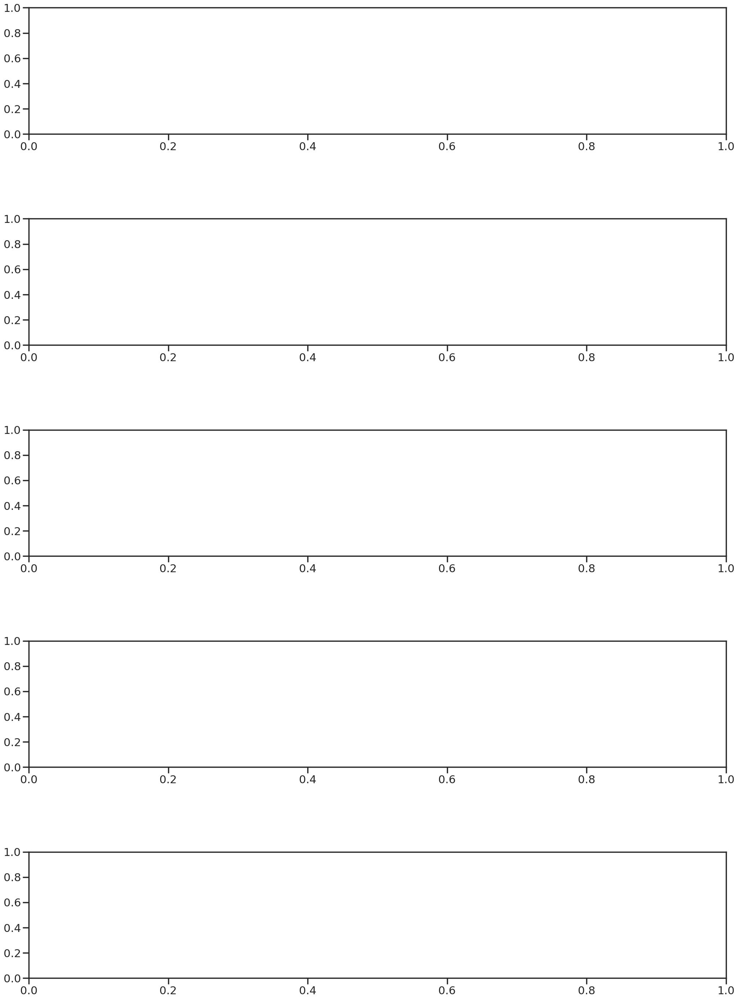

In [10]:
CNOM = ecio.load_CNOM(srcdir, 
                      prodmod_code="ECA_JXAB", 
                         renamer_datagroup={'phony_dim_0':'along_track', 'phony_dim_1':'CPR_height'},
                         renamer_geogroup={'phony_dim_3':'along_track', 'phony_dim_4':'CPR_height'})

ecplt.quicklook_CNOM(CNOM, dstdir=dstdir)

CNOM.close()

# Selected L2 products

In [14]:
srcdir = "/net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/L1/test_dir"
srcdir ='Working_DIR/'
dstdir = "demo_figures"

No EarthCARE product files match path /net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/EC_tools_only/Working_DIR//ECA_EX[A-Z][A-Z]_ATL_FM__2A_*_*_*/ECA_EX[A-Z][A-Z]_ATL_FM__2A_*_*_*.h5.


AttributeError: 'NoneType' object has no attribute 'encoding'

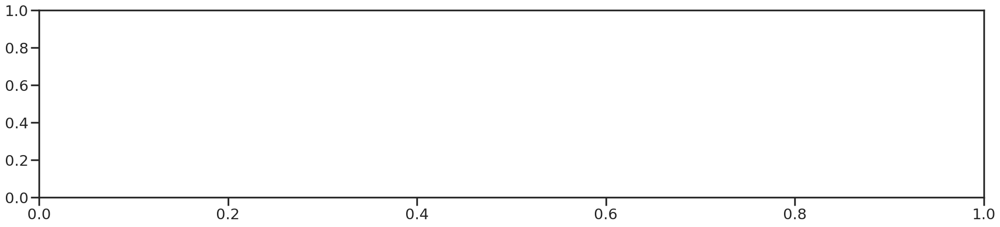

In [54]:
AFM = ecio.load_AFM(srcdir)
ecplt.quicklook_AFM(AFM, dstdir=dstdir)
AFM.close()

Selecting frame from 99 to 5045


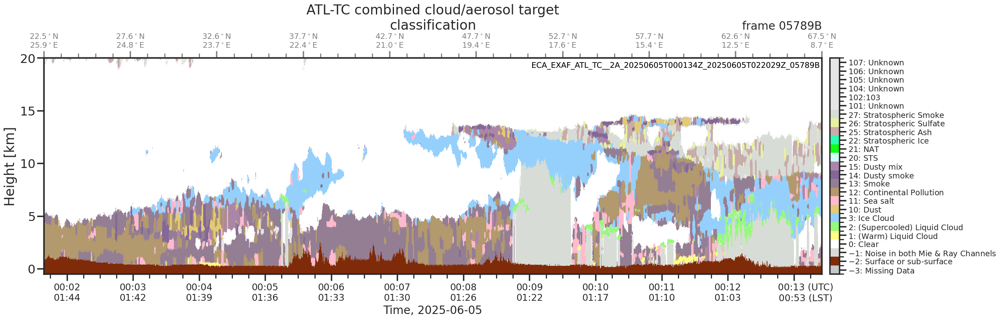

In [52]:
ATC = ecio.load_ATC(srcdir)

ecplt.quicklook_ATC(ATC, dstdir=dstdir)

ATC.close()

No EarthCARE product files match path Working_DIR//ECA_EX[A-Z][A-Z]_ATL_ICE_2A_*_*_*/ECA_EX[A-Z][A-Z]_ATL_ICE_2A_*_*_*.h5.


AttributeError: 'NoneType' object has no attribute 'encoding'

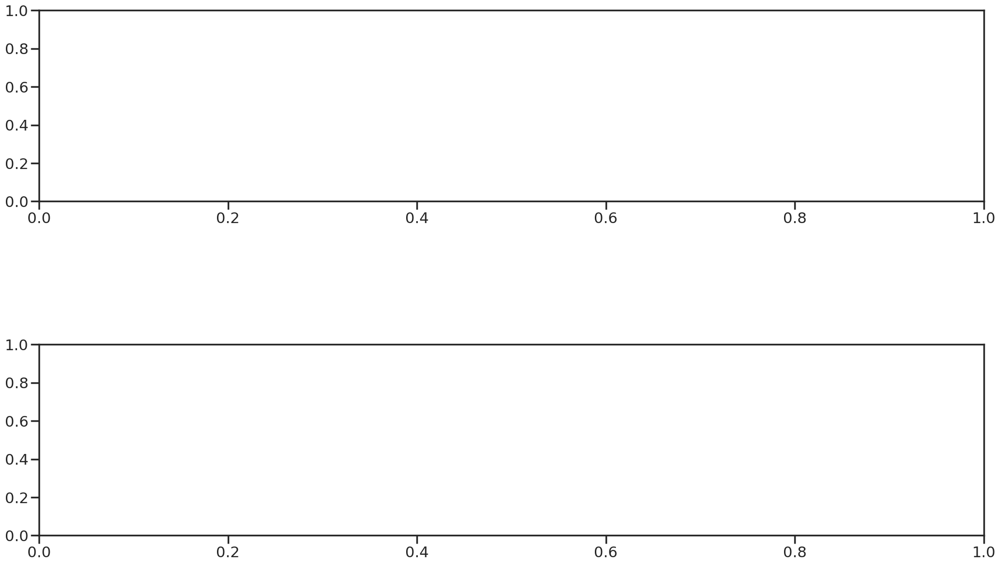

In [18]:
AICE = ecio.load_AICE(srcdir)

ecplt.quicklook_AICE(AICE, dstdir=dstdir)

AICE.close()

In [10]:
ATC_zoom


NameError: name 'ATC_zoom' is not defined

In [ ]:
CTC = ecio.load_CTC(srcdir)

ecplt.quicklook_CTC(CTC, dstdir=dstdir)

CTC.close()

In [ ]:
reload(ecplt)

CFMR = ecio.load_CFMR(srcdir)

ecplt.quicklook_CFMR(CFMR, dstdir=dstdir)

CFMR.close()

In [ ]:
CCD = ecio.load_CCD(srcdir)

ecplt.quicklook_CCD(CCD, dstdir=dstdir)

CCD.close()

In [ ]:
CCLD = ecio.load_CCLD(srcdir)

ecplt.quicklook_CCLD(CCLD, dstdir=dstdir)

CCLD.close()

Selecting frame from 97 to 5043


KeyError: "No variable named 'insect_detection_status'. Did you mean one of ('CPR_detection_status', 'ATLID_detection_status')?"

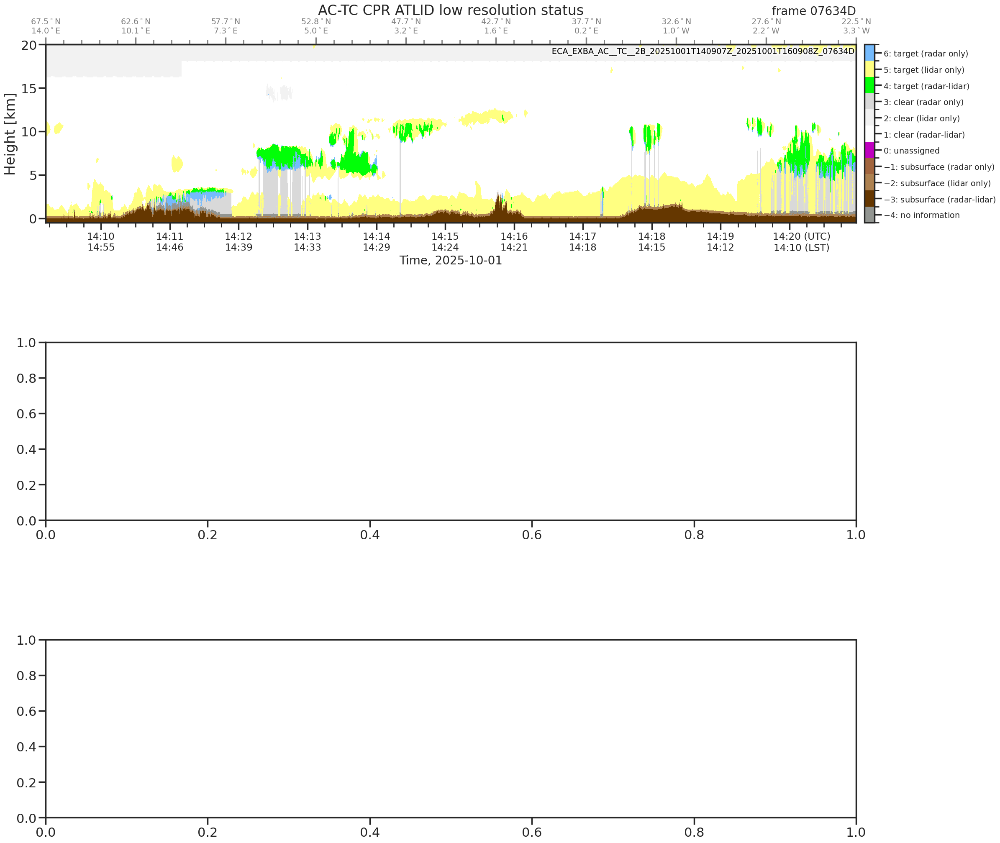

In [14]:
ACTC = ecio.load_ACTC(srcdir)

ecplt.quicklook_ACTC(ACTC, dstdir=dstdir)

ACTC.close()

In [ ]:
ACMCAP = ecio.load_ACMCAP(srcdir)

ecplt.quicklook_ACMCAP(ACMCAP, dstdir=dstdir)

ACMCAP.close()

In [ ]:
MCM = ecio.load_MCM(srcdir)

ecplt.quicklook_MCM(MCM, dstdir=dstdir)

MCM.close()

In [67]:
#
srcdir='/net/pc230016/nobackup_1/users/zadelhof/EarthCARE_DATA/EC_tools_only/Working_DIR/'

ACMRT = ecio.load_ACMRT(srcdir)
#ecplt.quicklook_ACMRT(ACMRT, dstdir=dstdir)
ACMRT

<xarray.Dataset>
Dimensions:                                              (atmosphere: 1,
                                                          view: 3,
                                                          along_track: 5143,
                                                          across_track: 207,
                                                          height_layer: 246,
                                                          height_level: 247)
Coordinates:
  * along_track                                          (along_track) int64 ...
Dimensions without coordinates: atmosphere, view, across_track, height_layer,
                                height_level
Data variables: (12/68)
    atmosphere_classification                            (atmosphere) float32 ...
    BBR_along_track_view                                 (view) float64 ...
    solar_zenith_angle                                   (along_track) float32 ...
    solar_zenith_angle_assessment_domain                 (along_track) float32 ...
    solar_azimuth_angle_assessment_domain                (along_track) float32 ...
    latitude_assessment_domain                           (along_track) float32 ...
    ...                                                   ...
    flux_up_thermal_3d_reference_height_all_sky          (atmosphere, along_track) float32 ...
    flux_up_thermal_3d_reference_height_all_sky_error_a  (atmosphere, along_track) float32 ...
    flux_up_thermal_3d_reference_height_all_sky_error_b  (atmosphere, along_track) float32 ...
    reference_height_3d_thermal_fluxes                   (atmosphere, along_track) float32 ...
    coregistration_height_3d_thermal_radiances           (along_track) float32 ...
    timing_thermal_3d                                    (along_track) float32 ...

(246, 5143)


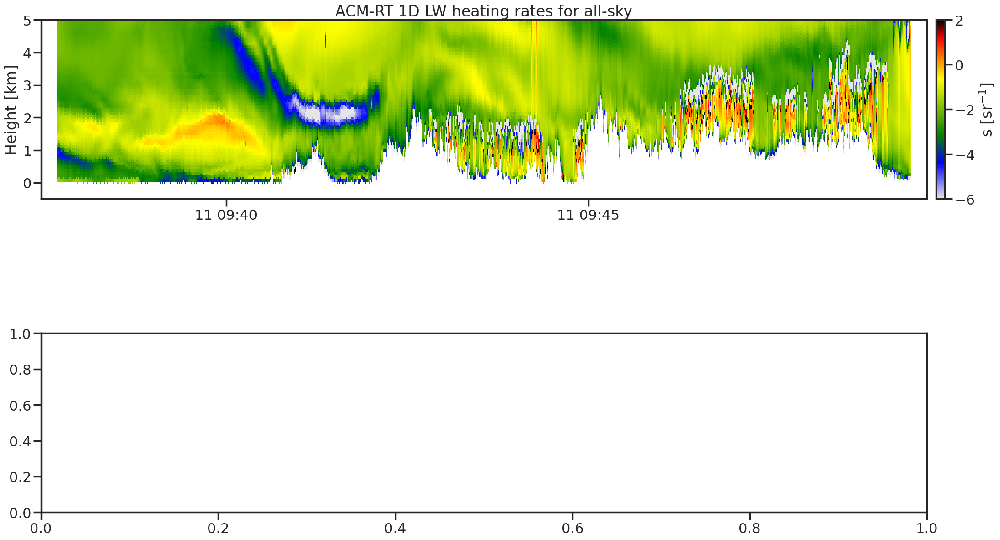

In [127]:

ACMRT = ecio.load_ACMRT(srcdir)
ACMRT2=ACMRT['heating_rate_solar_1d_all_sky'][0,:,:]
ACMRT3=ACMRT['heating_rate_thermal_1d_all_sky'][0,:,:]

ACMRT['heating_rate_solar_1d_all_sky']=ACMRT2
ACMRT['heating_rate_thermal_1d_all_sky']=ACMRT3
print(np.shape(ACMRT3))
from matplotlib.colors import LogNorm, Normalize, ListedColormap, LinearSegmentedColormap, ColorConverter
import pandas as pd

#plt.plot(ACMRT['time'],ACMRT2[10,:])

from ectools import colormaps
reload(ecio)
reload(ecplt)
    #reload(colormaps)
import matplotlib.cm as cm

hmax=5e3
#    cmap=colormaps.chiljet2()
cmap = cm.get_cmap('chiljet2') 
nrows=3
try:
    hmax=5e3
#    cmap=colormaps.chiljet2()
    cmap = cm.get_cmap('chiljet2') 
    nrows=2
    fig, axes = plt.subplots(figsize=(25,7*nrows), nrows=nrows, 
                             sharex=False, sharey=False, gridspec_kw={'hspace':0.75})

    i=0
    ecplt.plot_EC_2D(axes[i], ACMRT, 'heating_rate_thermal_1d_all_sky', "s", 
              cmap=cmap, plot_scale='linear', 
              hmax=hmax, units='sr$^{-1}$', heightvar='height_layers',
              plot_range=[-6,2])

    i=+1
    ecplt.plot_EC_2D(axes[i], ACMRT, 'heating_rate_solar_1d_all_sky', "s", 
              cmap=cmap, plot_scale='linear',  
              hmax=hmax, units='sr$^{-1}$', heightvar='height_layers',
              plot_range=[-2,2])


    i+=1
    ecplt.plot_EC_2D(axes[i], ACMRT, 'heating_rate_thermal_1d_all_sky', "s", 
              cmap=cmap, plot_scale='linear', 
              hmax=hmax, units='sr$^{-1}$', heightvar='height_layers',
              plot_range=[-20,20])

except:

    fg=1
